# Подготовка данных

In [ ]:
!git clone https://github.com/ultralytics/yolov5 
%cd yolov5
!pip install -r requirements.txt

import re
import torch
import os
import pathlib
import glob
from IPython.display import Image, clear_output, display
import random
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

In [ ]:
!pip install roboflow

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="6xQEqRQ0NTupOgINP2p8")
project = rf.workspace("asdasd-nwqom").project("faces-kpkzt")
dataset = project.version(2).download("yolov5")

In [ ]:
%%writefile dataset.yaml
train: Faces-2/train/images
val: Faces-2/valid/images

# Classes
nc: 1  # number of classes
names: ['face']

Writing dataset.yaml


# Обучение нейросети

In [ ]:
%%time
!python train.py --img 416 --batch 32 --epochs 200 --data dataset.yaml --cfg models/yolov5l.yaml --weights yolov5l.pt --name yolov5l_results  --cache

train: weights=yolov5l.pt, cfg=models/yolov5l.yaml, data=dataset.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=200, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5l_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-216-g6e544d5 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv

In [ ]:
from google.colab import files
files.download("runs/train/yolov5l_results2/weights/best.pt")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# значения метрик при обучении на 200 эпохах
!python val.py --weights runs/train/yolov5l_results2/weights/best.pt --data dataset.yaml --img 416 --half

Результаты обучения на 200 эпох:

- Images: 442
- Instances: 2268         
- P: 0.972          
- R: 0.928
- mAP50: 0.968
- mAP50-95: 0.784
- box_loss: 0.01081
- obj_loss: 0.01204

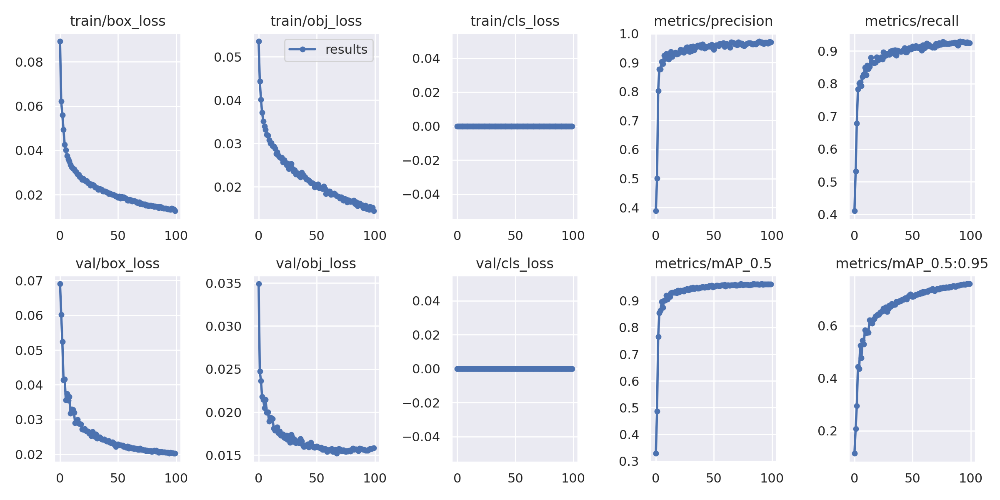

In [ ]:
# результаты обучения 100 эпох
Image(filename='/content/yolov5/runs/train/yolov5l_results/results.png', width=1000) 

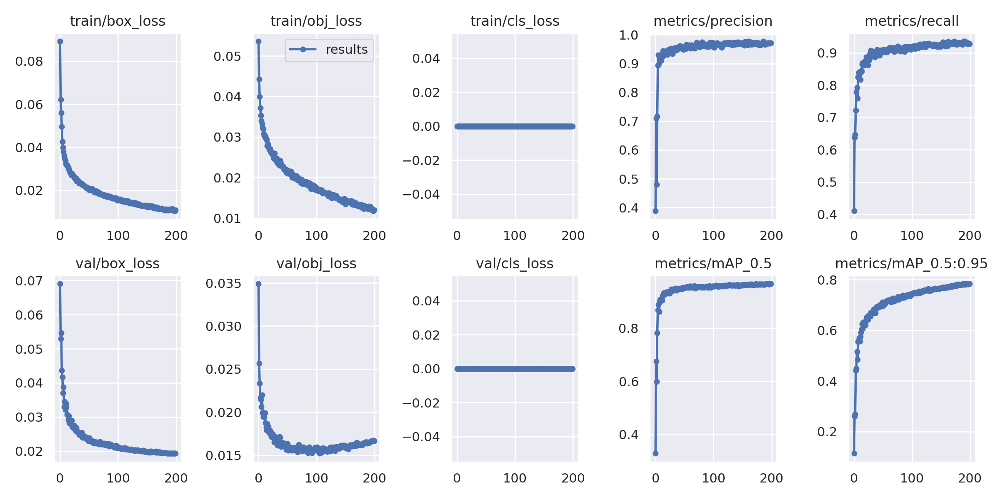

In [ ]:
# результаты обучения 200 эпох
Image(filename='/content/yolov5/runs/train/yolov5l_results2/results.png', width=1000) 

# Валидация (inference)

In [ ]:
!python detect.py --weights runs/train/yolov5l_results2/weights/best.pt --img 416 --conf 0.45 --iou 0.6 --source ../maxresdefault.jpg

detect: weights=['runs/train/yolov5l_results2/weights/best.pt'], source=../maxresdefault.jpg, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.45, iou_thres=0.6, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-216-g6e544d5 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5l summary: 267 layers, 46108278 parameters, 0 gradients, 107.6 GFLOPs
image 1/1 /content/maxresdefault.jpg: 256x416 1 face, 21.6ms
Speed: 0.3ms pre-process, 21.6ms inference, 1.4ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp4


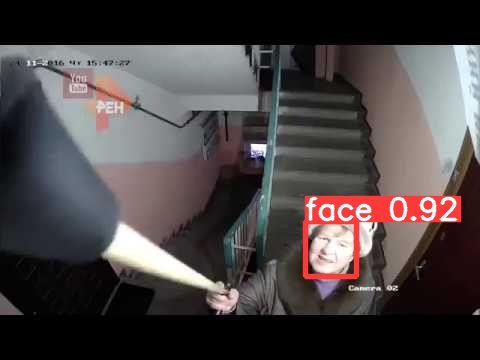

In [ ]:
for imageName in glob.glob('/content/yolov5/runs/detect/exp3/*.jpg'):
    display(Image(filename=imageName))
    print("\n")

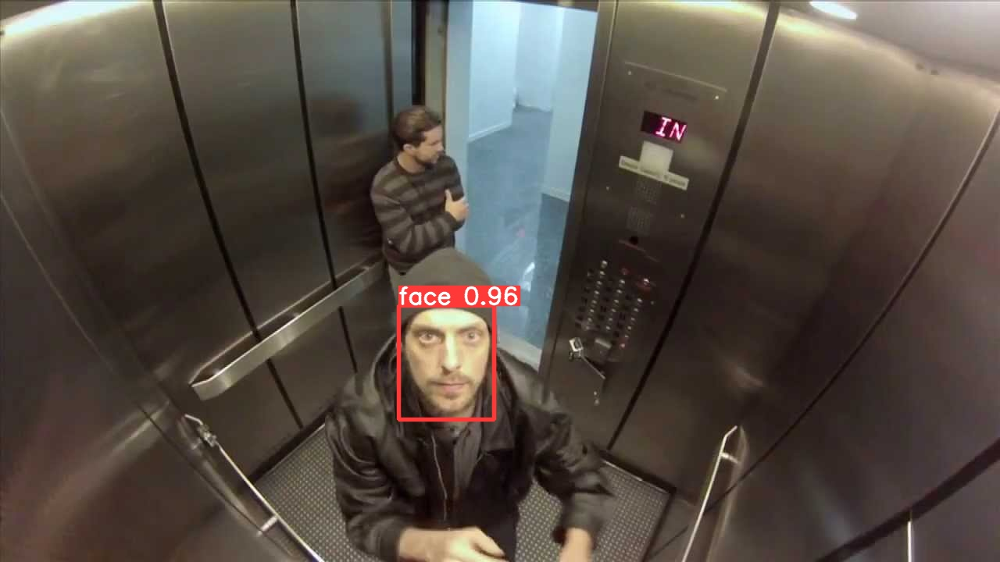

In [ ]:
for imageName in glob.glob('/content/yolov5/runs/detect/exp4/*.jpg'): 
    display(Image(filename=imageName))
    print("\n")

In [ ]:
!python detect.py --weights runs/train/yolov5l_results/weights/best.pt --img 416 --conf 0.4 --source Faces-2/test/images

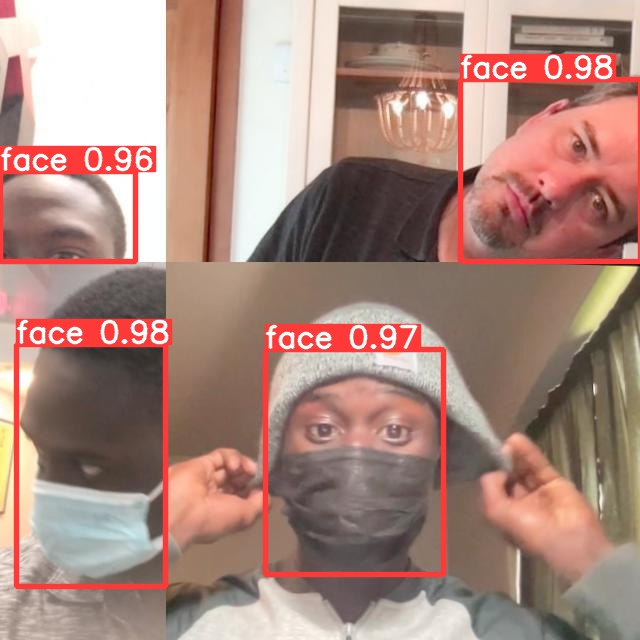

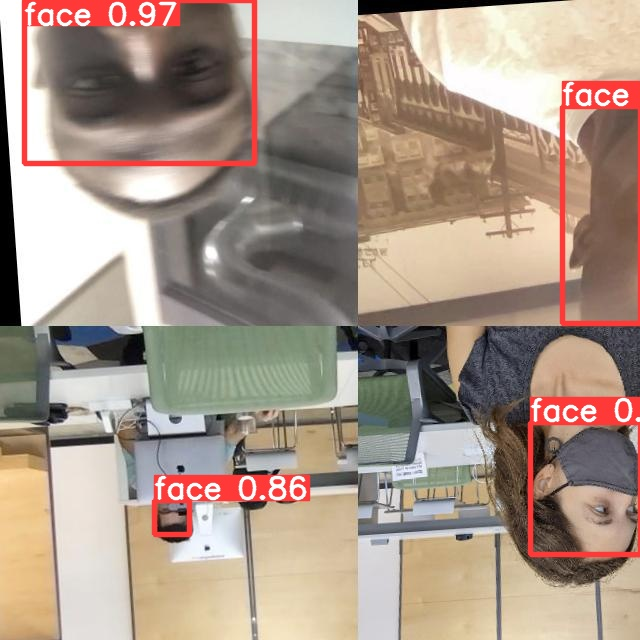

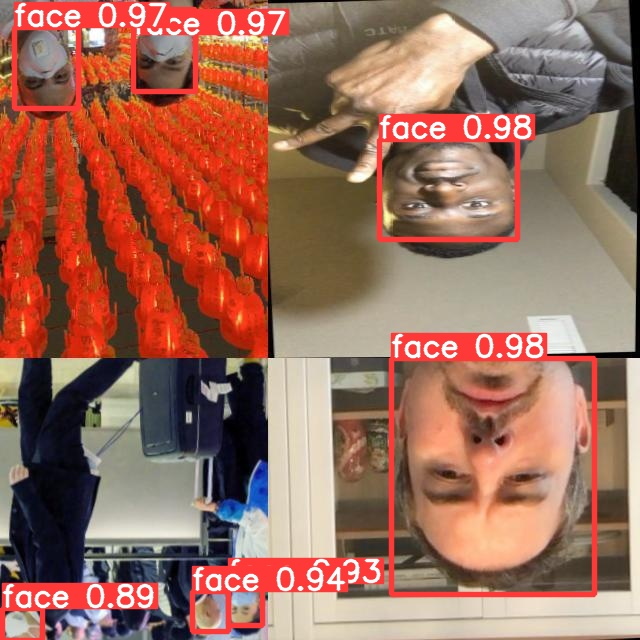

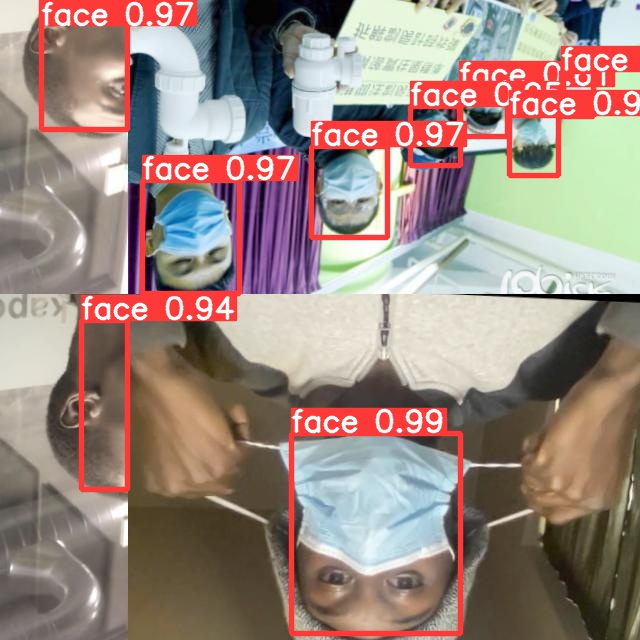

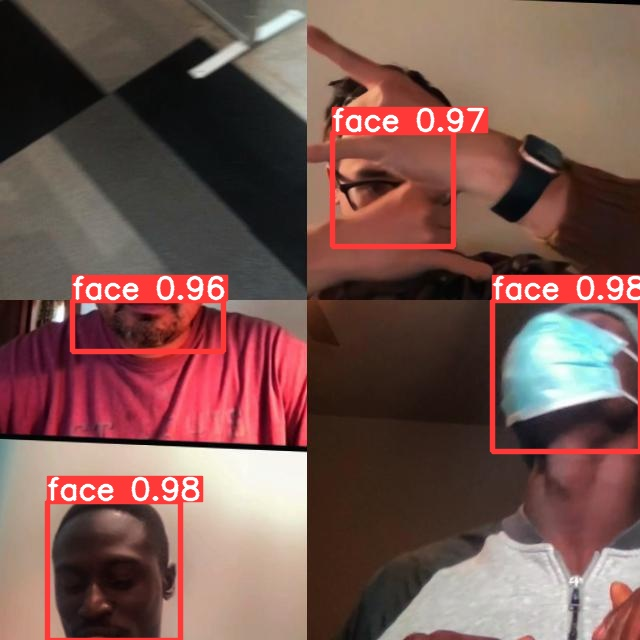

...

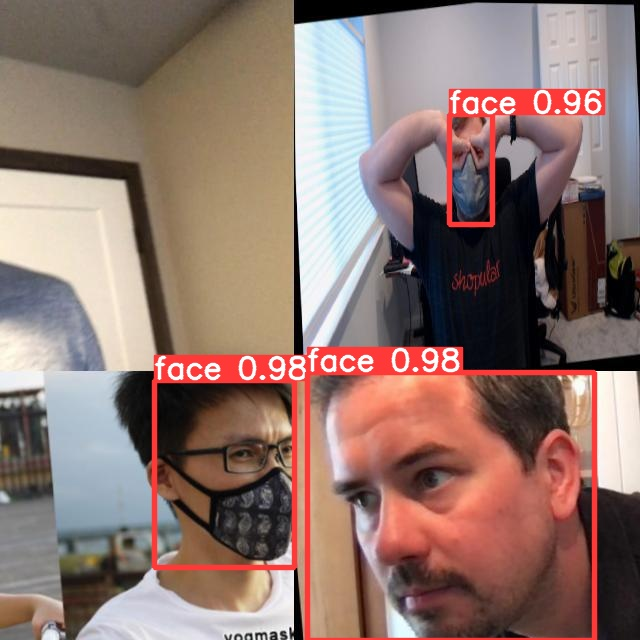

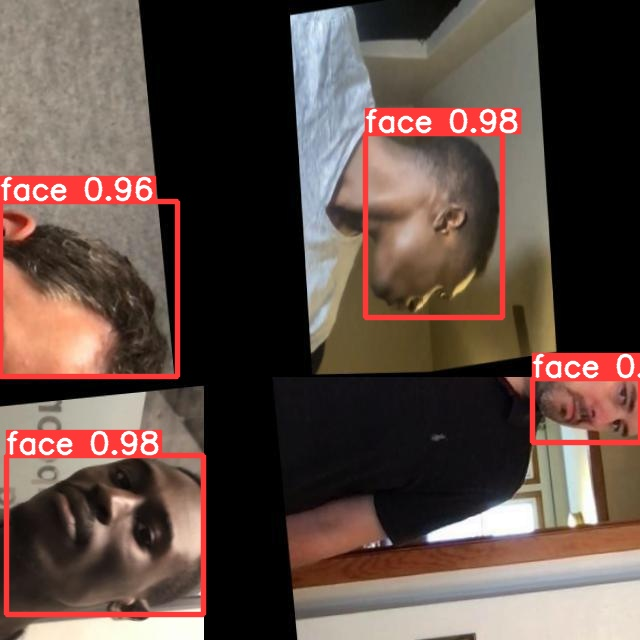

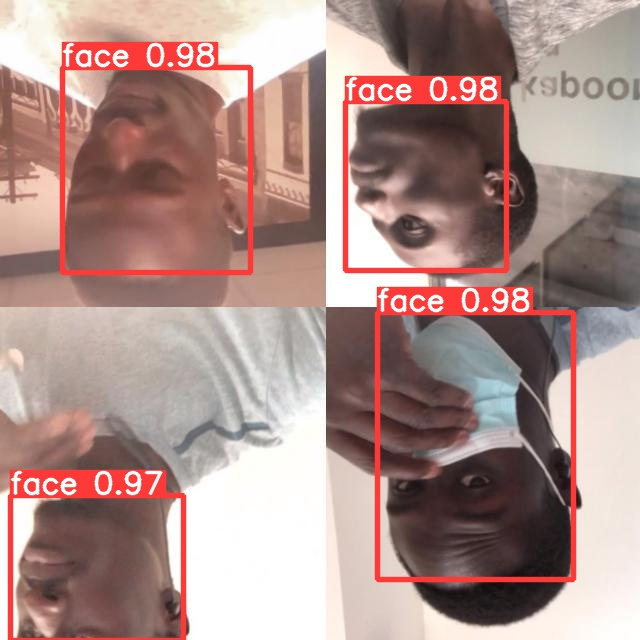

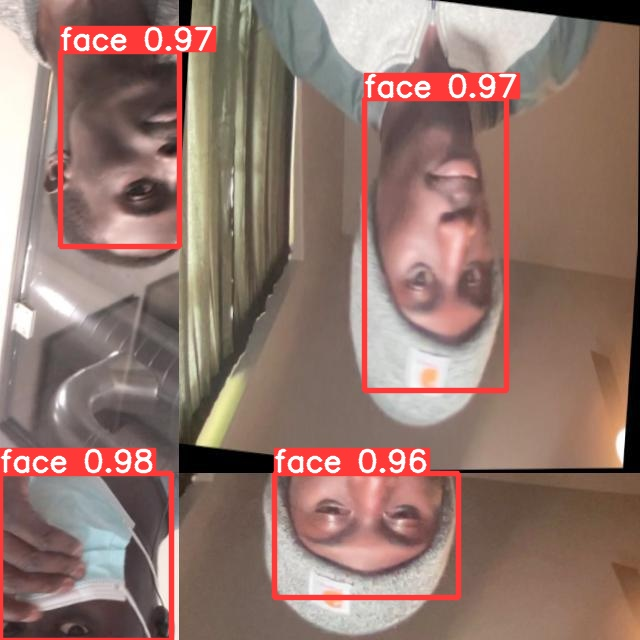

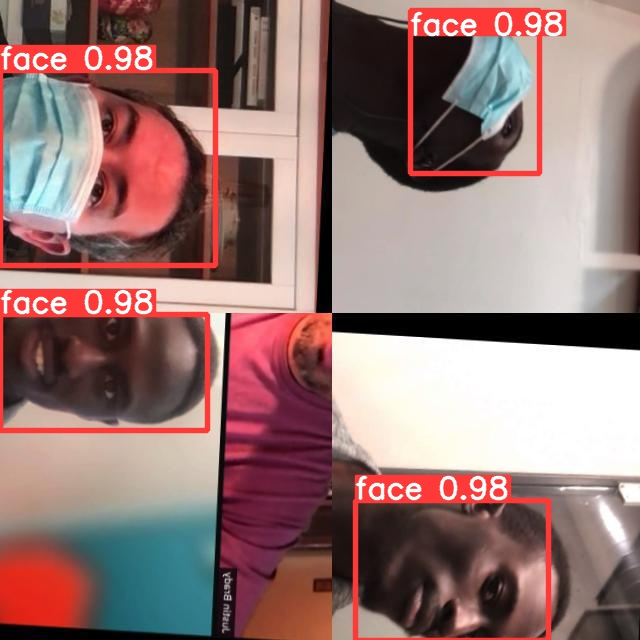

In [ ]:
for imageName in glob.glob('/content/yolov5/runs/detect/exp2/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Выводы и гипотезы по улучшению

### Улучшение датасета
- Рекомендуется ≥1500 изображений и ≥10000 экземпляров/instances (помеченных объектов) для каждого класса
- Разнообразие изображений: разное время суток, разное освещение, с разных ракурсов, из разных источников (взятые онлайн, собранные локально, с разных камер) и т.д.
- У каждого изображения есть своя аннотация/label (написать скрипт для проверки)
- Добавить 0-10% фоновых изображений. Фоновые изображения - это изображения без объектов, которые добавляются в набор данных для уменьшения ложных срабатываний (FP). Для фоновых изображений аннотации не требуются.

### Настройки обучения
- Начать с 300 эпох. Если переобучение произойдет слишком рано, то сократить периоды. 
- Размер батчей/партии. Используйте самый большой размер, который позволяет ваше оборудование. Небольшие размеры партии приводят к плохой статистике batchnorm, и их следует избегать.--размер партии